In [135]:
import sys
sys.path.append("..")
import numpy as np
import pandas as pd
from project.ship import Ship
from project.tests import Tests
from project.botma import TMA
import time

In [2]:
observer_x, observer_y, observer_course, observer_velocity = 0, 0, 0, 5
observer = Ship('Наблюдатель', observer_x, observer_y, observer_course,
                observer_velocity, verbose=True)
observer.forward_movement(3 * 60)
observer.change_course(270, 'left', omega=0.5)
observer.forward_movement(5 * 60)
observer.change_course(90, 'right', omega=0.5)
observer.forward_movement(3 * 60)
tests = Tests('test1')

Наблюдатель движется прямо по курсу 0.0° 180с
Наблюдатель перешёл на курс 270.0° за 180с
Наблюдатель движется прямо по курсу 270.0° 300с
Наблюдатель перешёл на курс 90.0° за 360с
Наблюдатель движется прямо по курсу 90.0° 180с


In [3]:
def target_func(seed=None):
    np.random.seed(seed)
    b = 0
    d = 10
    c = np.random.uniform(0, 180)
    v = np.random.uniform(3, 15)
    return [b, d, c, v]
p0 = [0., 25., 90., 7.]
precisions = ['{0:.1f}', '{0:.3f}', '{0:.3f}', '{0:.2f}', '{0:.1f}', '{0:.3f}', '{0:.3f}', '{0:.2f}', '{0:.1f}', '{0:.3f}', '{0:.3f}', '{0:.2f}',
'{0:.2f}','{0:.3f}','{0:.2f}', '{0:.2f}', '{0:.2f}', '{0:.2f}', '{0:.2f}', '{0:.2f}', '{:.0f}', '{0:.4f}', '{0:.0f}', '{0:.0f}']

In [4]:
tma = TMA(observer, std=np.radians(0.5))
tma.print_verbose()
print('ММП v2')
start_time = time.perf_counter()
dict_results = tma.swarm(n=10000, target_func=target_func, p0=p0, seeded=True)
stop_time = time.perf_counter()
print('Моделирование 10000 результатов закончено за t = {:.1f} с'.format(stop_time - start_time))
df = tests.get_df(dict_results)

СКОп = 0.5, tau = 2
ММП v2
Моделирование 10000 результатов закончено за t = 59.3 с


In [141]:
df.head().round(3)

,П0_ист,Д0_ист,К0_ист,V0_ист,П0_расч,Д0_расч,К0_расч,V0_расч,П0_апр,Д0_апр,...,СКО X,СКО Y,СКО VX,СКО VY,Ка,Кб,Точ,t,Nf,Iter
0,0,10,98.786,11.582,-0.020,10.134,11.695,-1.826,0.0,25.0,...,0.015,0.209,0.330,0.079,0.250,0.115,"[1, 1, 1, 1]",0.004,19,15
1,0,10,75.064,11.644,0.005,9.830,10.966,2.962,0.0,25.0,...,0.014,0.152,0.243,0.057,0.249,0.125,"[1, 1, 1, 1]",0.003,12,10
2,0,10,78.479,3.311,0.013,10.037,3.202,0.562,0.0,25.0,...,0.011,0.071,0.066,0.065,0.264,0.116,"[1, 1, 1, 1]",0.002,8,7
3,0,10,99.144,11.498,0.018,9.910,11.144,-1.817,0.0,25.0,...,0.014,0.197,0.308,0.076,0.261,0.077,"[1, 1, 1, 1]",0.004,19,15
4,0,10,174.065,9.567,-0.006,10.080,1.019,-9.610,0.0,25.0,...,0.005,0.062,0.020,0.075,0.235,0.073,"[1, 1, 1, 1]",0.005,24,18


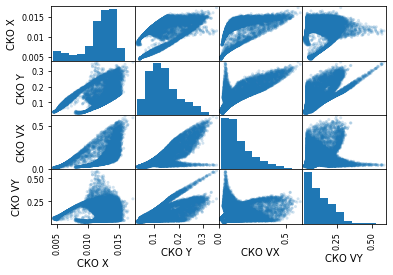